In [1]:
## importing all the necessary packages

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import cv2
import os

In [2]:
direc = os.getcwd()[0:-8] + 'videos'
df = pd.read_csv(direc + '\\csv_output\\AC_SOC2_7DLC_resnet50_social_behavior_allMay27shuffle1_250000.csv', header = [1, 2])

In [3]:
def prepare_coordinates(direc):
    
    import numpy as np
    from shapely.geometry import Point
    from shapely.geometry.polygon import Polygon
    
    ## will want to start things off by loading in the coordinates drawn (this should be done beforehand)

    left_side = np.loadtxt(direc + 'left_side')
    x_chamber = np.loadtxt(direc + 'x_chamber')
    y_chamber = np.loadtxt(direc + 'y_chamber')
    right_side = np.loadtxt(direc + 'right_side')
    middle = np.loadtxt(direc + 'middle')
    
    ## calculate the padded interaction zone, that is 25 pixels larger in every direction (than the base of the chamber)

    x_outer = Polygon(Polygon(x_chamber).buffer(40.0).exterior).exterior.coords.xy
    y_outer = Polygon(Polygon(y_chamber).buffer(40.0).exterior).exterior.coords.xy
    x_center = np.mean(x_outer[0]), np.mean(x_outer[1])
    y_center = np.mean(y_outer[0]), np.mean(y_outer[1])
    
    x_zone = Polygon(Polygon(x_chamber).buffer(40.0).exterior)
    y_zone = Polygon(Polygon(y_chamber).buffer(40.0).exterior)
    
    possible_places = {'x_zone': x_zone, 'y_zone': y_zone, 'left_side': left_side, 'middle': middle, 'right_side': right_side}
    extra_coords = {'x_outer': x_outer, 'x_center': x_center, 'y_outer': y_outer, 'y_center': y_center, 'x_chamber': x_chamber, 'y_chamber': y_chamber}
    
    return possible_places, extra_coords

In [4]:
possible_places, extra_coords = prepare_coordinates(os.getcwd() + '\\coordinates\\')

In [6]:
## reading in a test dataframe of coordinate values, plotting the likelihoods throughout the trial, and then plotting a heatmap of where
## the mouse's nose was, so that you can adjust the chamber location if necessary (but it looks good in this case)

def soc_behavior_heatmap(df, coordinates, videoname, trial_frames = (450, 7500)):

    fig, ax = plt.subplots(1,1,figsize=(14.4,9.6))
    ax.plot(df['nose']['x'].loc[trial_frames[0]:trial_frames[1]], df['nose']['y'].loc[trial_frames[0]:trial_frames[1]], c='k', alpha=.3, marker='o', linestyle='None')
    ax.plot(coordinates[0]['left_side'][:,0], coordinates[0]['left_side'][:,1], color = 'red', linewidth = 4)
    ax.plot(coordinates[0]['right_side'][:,0], coordinates[0]['right_side'][:,1], color = 'purple', linewidth = 4)
    ax.plot(coordinates[1]['x_chamber'][:,0], coordinates[1]['x_chamber'][:,1], color = 'blue', linewidth = 4)
    ax.plot(coordinates[1]['y_chamber'][:,0], coordinates[1]['y_chamber'][:,1], color = 'green', linewidth = 4)
    ax.plot(coordinates[1]['x_outer'][0], coordinates[1]['x_outer'][1], color = 'blue', linewidth = 4)
    ax.plot(coordinates[1]['y_outer'][0], coordinates[1]['y_outer'][1], color = 'green', linewidth = 4)
    ax.plot(coordinates[1]['x_center'][0], coordinates[1]['x_center'][1], 'bo')
    ax.plot(coordinates[1]['y_center'][0], coordinates[1]['y_center'][1], 'go')
    plt.xlim(0,1280)
    plt.ylim(0,720)
    plt.title(videoname);

In [6]:
videos = os.listdir(direc + '\\mp4s')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max

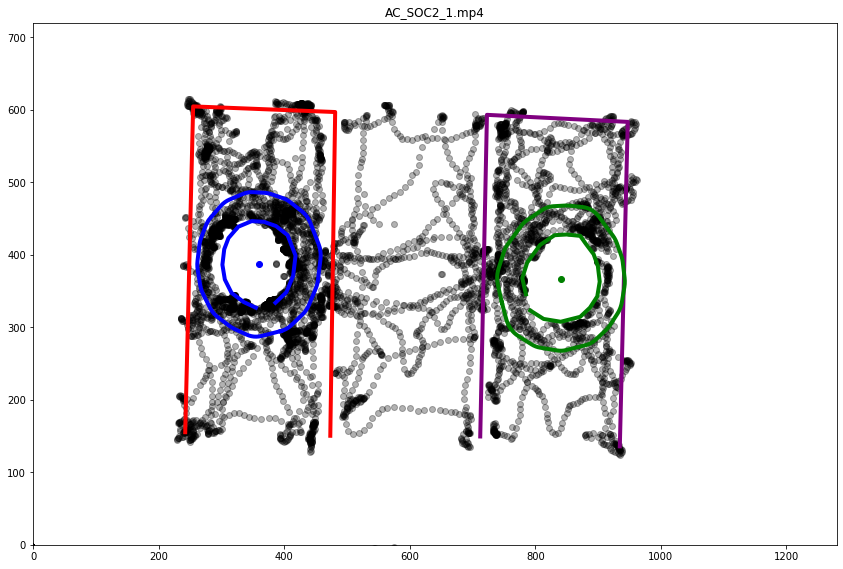

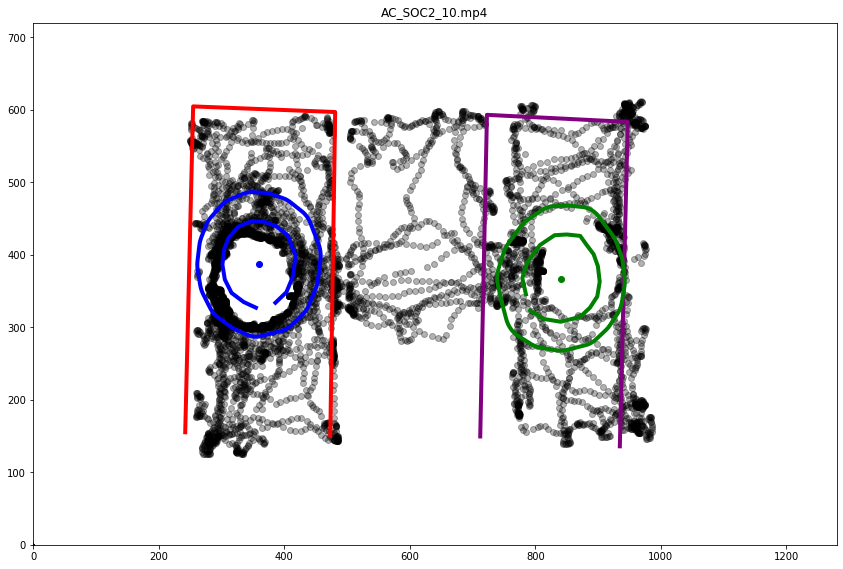

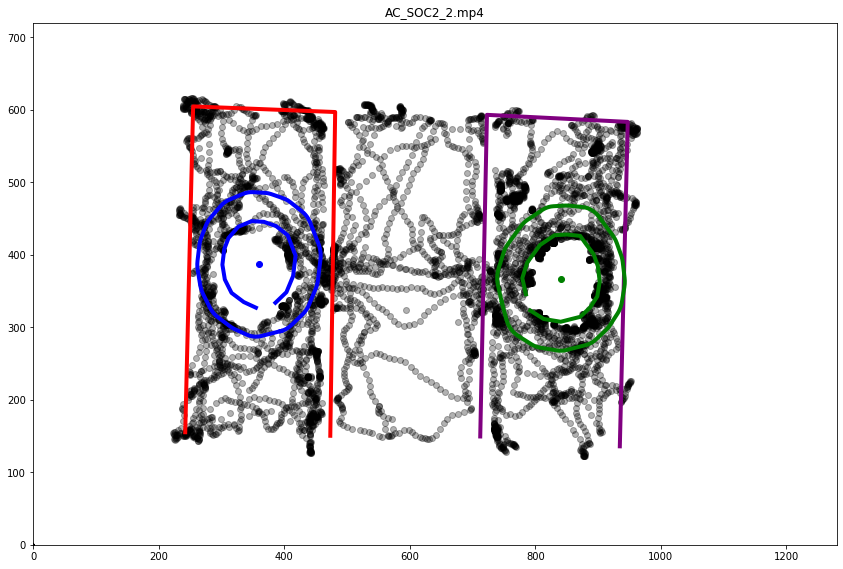

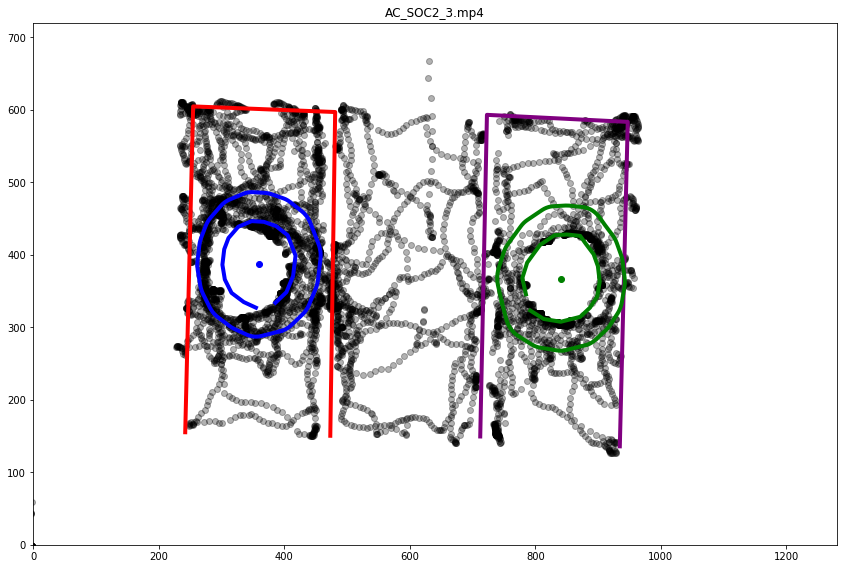

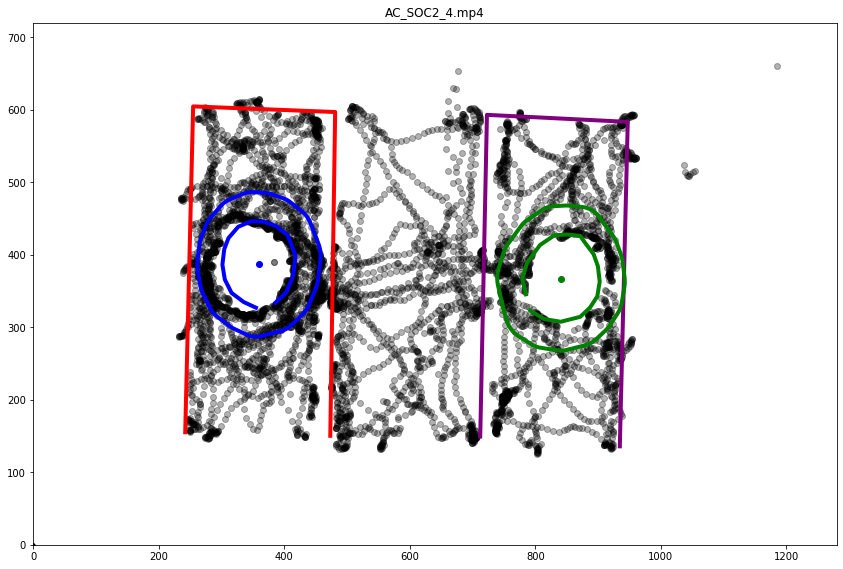

...

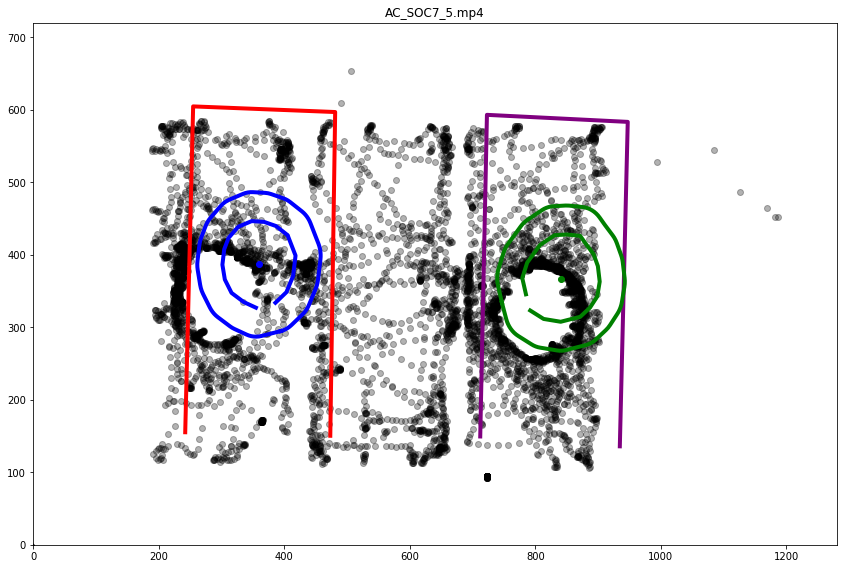

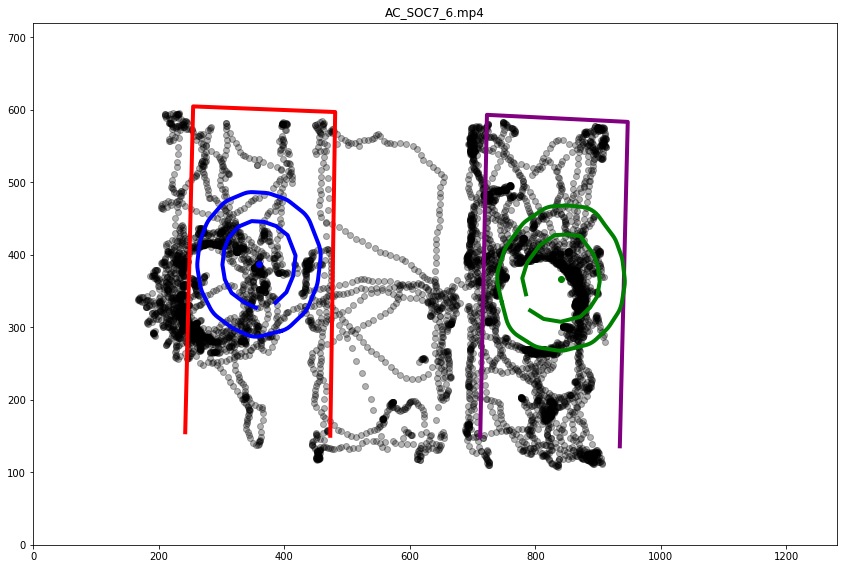

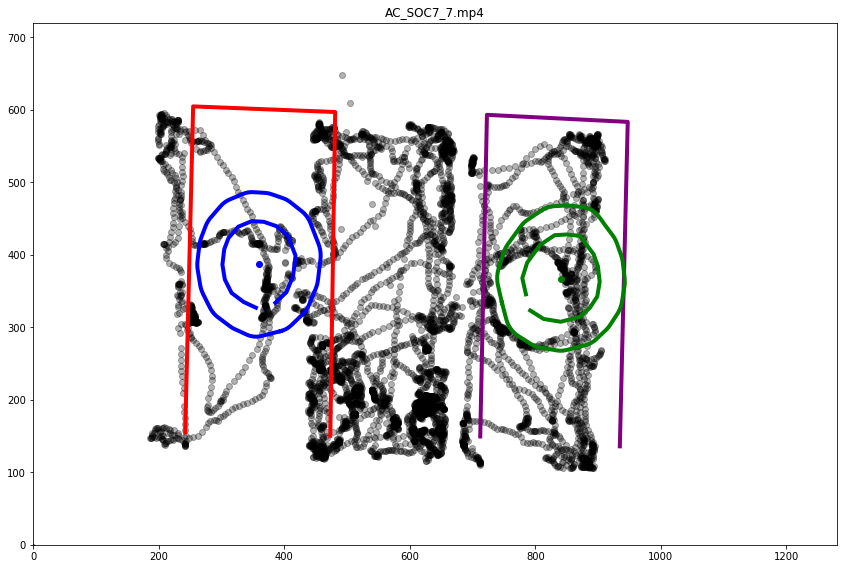

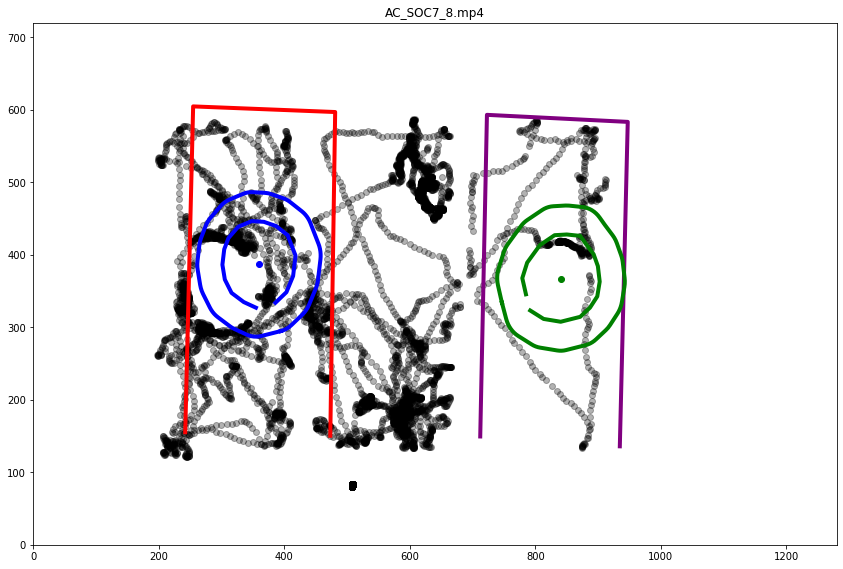

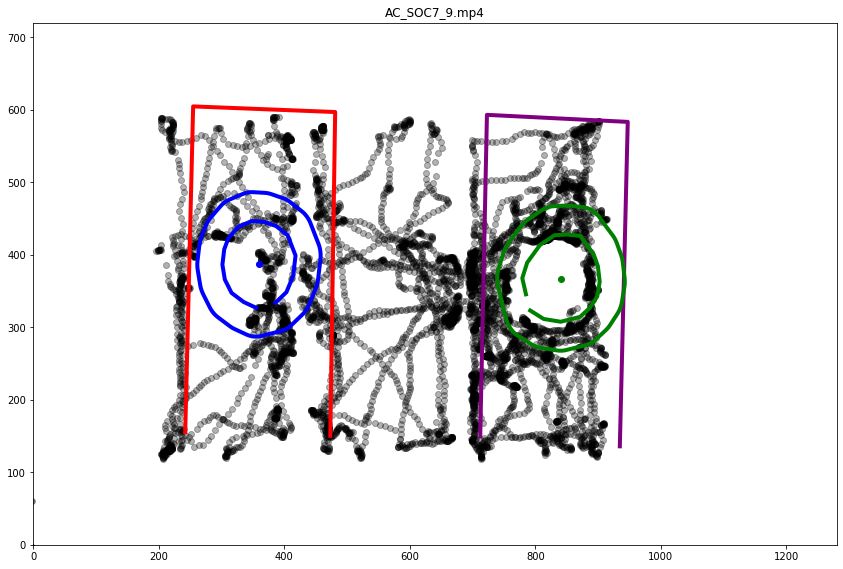

In [7]:
for video in videos:
    df = pd.read_csv(direc + '\\csv_output\\' + video[0:-4] + 'DLC_resnet50_social_behavior_allMay27shuffle1_250000.csv', header = [1, 2])
    soc_behavior_heatmap(df, [possible_places, extra_coords], video)

In [7]:
def soc_behavior_heatmap_overlap(df, coordinates, video_location, trial_frames = (450,7500)):
    
    cap = cv2.VideoCapture(video_location)
    frameWidth = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frameHeight = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    buf = np.empty((10, frameHeight, frameWidth, 3), np.dtype('uint8'))
    fc = 0
    ret = True

    while (fc < 1  and ret):
        ret, buf[fc] = cap.read()
        fc += 1
    cap.release()
    frame = buf[0]

    fig, ax = plt.subplots(1,1,figsize=(14.4,9.6))
    ax.plot(df['nose']['x'].loc[trial_frames[0]:trial_frames[1]], df['nose']['y'].loc[trial_frames[0]:trial_frames[1]], c='k', alpha=.3, marker='o', linestyle='None')
    ax.plot(coordinates[0]['left_side'][:,0], coordinates[0]['left_side'][:,1], color = 'red', linewidth = 4)
    ax.plot(coordinates[0]['right_side'][:,0], coordinates[0]['right_side'][:,1], color = 'purple', linewidth = 4)
    ax.plot(coordinates[1]['x_chamber'][:,0], coordinates[1]['x_chamber'][:,1], color = 'blue', linewidth = 4)
    ax.plot(coordinates[1]['y_chamber'][:,0], coordinates[1]['y_chamber'][:,1], color = 'green', linewidth = 4)
    ax.plot(coordinates[1]['x_outer'][0], coordinates[1]['x_outer'][1], color = 'blue', linewidth = 4)
    ax.plot(coordinates[1]['y_outer'][0], coordinates[1]['y_outer'][1], color = 'green', linewidth = 4)
    ax.plot(coordinates[1]['x_center'][0], coordinates[1]['x_center'][1], 'bo')
    ax.plot(coordinates[1]['y_center'][0], coordinates[1]['y_center'][1], 'go')
    ax.imshow(frame)
    plt.xlim(0,frameWidth)
    plt.ylim(0,frameHeight)
    plt.title(video_location[-13:])

In [8]:
os.listdir(direc + '\\mp4s')[0]

'AC_SOC2_1.mp4'

In [9]:
video_location = direc + '\\mp4s\\' + 'AC_SOC2_7.mp4'

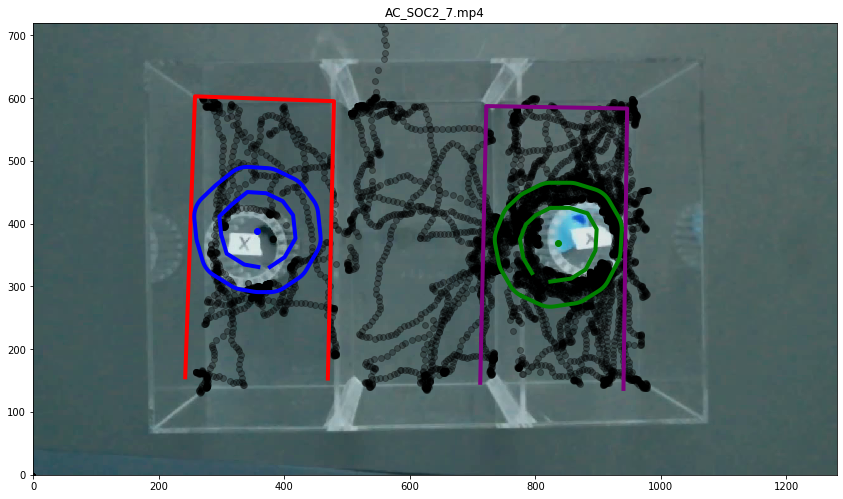

In [10]:
soc_behavior_heatmap_overlap(df, [possible_places, extra_coords], video_location)

In [12]:
df = pd.read_csv(direc + '\\csv_output\\AC_SOC2_3DLC_resnet50_social_behavior_allMay27shuffle1_250000.csv', header = [1, 2])
video_location = direc + '\\mp4s\\' + 'AC_SOC2_3.mp4'

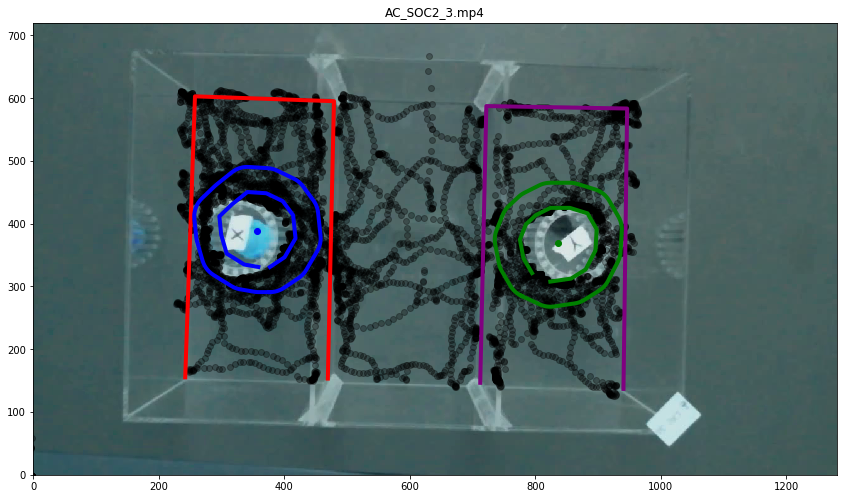

In [13]:
soc_behavior_heatmap_overlap(df, [possible_places, extra_coords], video_location)

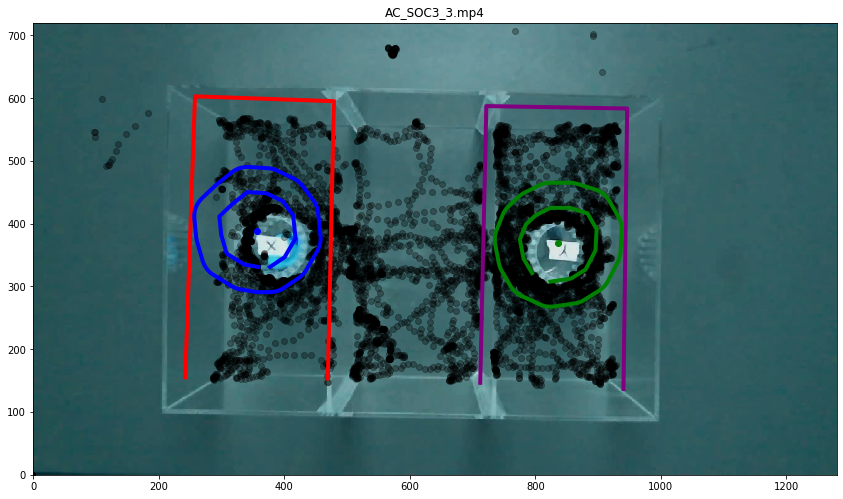

In [14]:
df = pd.read_csv(direc + '\\csv_output\\AC_SOC3_3DLC_resnet50_social_behavior_allMay27shuffle1_250000.csv', header = [1, 2])
video_location = direc + '\\mp4s\\' + 'AC_SOC3_3.mp4'
soc_behavior_heatmap_overlap(df, [possible_places, extra_coords], video_location)

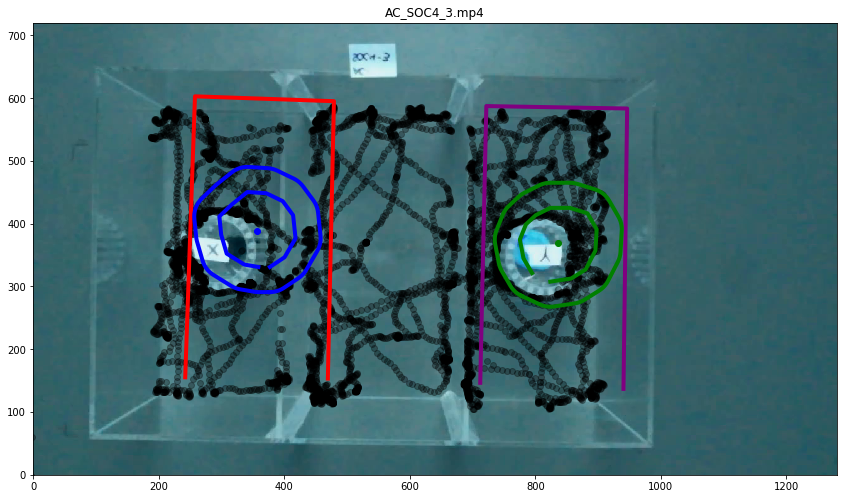

In [15]:
df = pd.read_csv(direc + '\\csv_output\\AC_SOC4_3DLC_resnet50_social_behavior_allMay27shuffle1_250000.csv', header = [1, 2])
video_location = direc + '\\mp4s\\' + 'AC_SOC4_3.mp4'
soc_behavior_heatmap_overlap(df, [possible_places, extra_coords], video_location)